# Lending Club Case Study

## **Problem Statement**

A famous online loan providing company want to minimise its lending risk i.e. 'defaulters'. Therefore, they wants to understand the driving factors (or driver variables) behind loan default, i.e. the variables which are strong indicators of default.  The company can utilise this knowledge for its portfolio and risk assessment. 

## **Solution**

In [1]:
#import the libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
#read the dataset and check the first five rows
df = pd.read_csv('.\loan.csv')
df.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


In [3]:
#Check the shape of the dataframe
df.shape

(39717, 111)

In [4]:
#checking dataframe info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Columns: 111 entries, id to total_il_high_credit_limit
dtypes: float64(74), int64(13), object(24)
memory usage: 33.6+ MB


### Data Handling and Cleaning

In [5]:
#Check the number of null values in the columns
null_cols, cor_cols, fine_cols = '', '', ''
for col in df.columns:
    col_null_per = round((df[col].isnull().sum()/len(df))*100)
    if col_null_per > 30:
        null_cols = f'{null_cols},{col}' if null_cols else col
    elif col_null_per > 0 and col_null_per <= 30:
        cor_cols = f'{cor_cols},{col}' if cor_cols else col
    else:
        fine_cols = f'{fine_cols},{col}' if fine_cols else col   

drop_cols_lst = null_cols.split(',')
cor_cols_lst = cor_cols.split(',')
fine_cols_lst = fine_cols.split(',')

In [6]:
print(f'Completely NULL columns list (where more than 30% records are null) - {len(drop_cols_lst)}')
print(drop_cols_lst)

Completely NULL columns list (where more than 30% records are null) - 58
['desc', 'mths_since_last_delinq', 'mths_since_last_record', 'next_pymnt_d', 'mths_since_last_major_derog', 'annual_inc_joint', 'dti_joint', 'verification_status_joint', 'tot_coll_amt', 'tot_cur_bal', 'open_acc_6m', 'open_il_6m', 'open_il_12m', 'open_il_24m', 'mths_since_rcnt_il', 'total_bal_il', 'il_util', 'open_rv_12m', 'open_rv_24m', 'max_bal_bc', 'all_util', 'total_rev_hi_lim', 'inq_fi', 'total_cu_tl', 'inq_last_12m', 'acc_open_past_24mths', 'avg_cur_bal', 'bc_open_to_buy', 'bc_util', 'mo_sin_old_il_acct', 'mo_sin_old_rev_tl_op', 'mo_sin_rcnt_rev_tl_op', 'mo_sin_rcnt_tl', 'mort_acc', 'mths_since_recent_bc', 'mths_since_recent_bc_dlq', 'mths_since_recent_inq', 'mths_since_recent_revol_delinq', 'num_accts_ever_120_pd', 'num_actv_bc_tl', 'num_actv_rev_tl', 'num_bc_sats', 'num_bc_tl', 'num_il_tl', 'num_op_rev_tl', 'num_rev_accts', 'num_rev_tl_bal_gt_0', 'num_sats', 'num_tl_120dpd_2m', 'num_tl_30dpd', 'num_tl_90g_d

In [7]:
print(f'Partial NULL columns list (where less than or equal to 30% records are null) - {len(cor_cols_lst)}')
print(cor_cols_lst)

Partial NULL columns list (where less than or equal to 30% records are null) - 3
['emp_title', 'emp_length', 'pub_rec_bankruptcies']


In [8]:
print(f'Non NULL columns list (where no null record) - {len(fine_cols_lst)}')
print(fine_cols_lst)

Non NULL columns list (where no null record) - 50
['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'home_ownership', 'annual_inc', 'verification_status', 'issue_d', 'loan_status', 'pymnt_plan', 'url', 'purpose', 'title', 'zip_code', 'addr_state', 'dti', 'delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_bal', 'revol_util', 'total_acc', 'initial_list_status', 'out_prncp', 'out_prncp_inv', 'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee', 'recoveries', 'collection_recovery_fee', 'last_pymnt_d', 'last_pymnt_amnt', 'last_credit_pull_d', 'collections_12_mths_ex_med', 'policy_code', 'application_type', 'acc_now_delinq', 'chargeoff_within_12_mths', 'delinq_amnt', 'tax_liens']


#### Missing Value Treatment

In [9]:
#dropping completly null columns & re-checking data set
df = df.drop(columns=drop_cols_lst)
df.shape

(39717, 53)

In [10]:
#reviewing partial null columns
df[cor_cols_lst ].head()

,emp_title,emp_length,pub_rec_bankruptcies
0,NaN,10+ years,0.0
1,Ryder,< 1 year,0.0
2,NaN,10+ years,0.0
3,AIR RESOURCES BOARD,10+ years,0.0
4,University Medical Group,1 year,0.0


#### Imputing Missing Values

- For numerical variables use mean and median
- For categorical variables use mode

In [11]:
#Check the nulls in the emp title column
df['emp_title'].isnull().sum()

2459

In [12]:
#reviewing emp title column statistic
df['emp_title'].describe()

count       37258
unique      28820
top       US Army
freq          134
Name: emp_title, dtype: object

In [13]:
#Replace the nulls in the emp title column with the above value
df['emp_title'] = df['emp_title'].fillna(df['emp_title'].mode()[0])
#Check the nulls in the emp title column again to cross-verify
df['emp_title'].isnull().sum()

0

In [14]:
#Check the nulls in the emp length column
df['emp_length'].isnull().sum()

1075

In [15]:
#reviewing emp length column statistic
df['emp_length'].describe()

count         38642
unique           11
top       10+ years
freq           8879
Name: emp_length, dtype: object

In [16]:
#Replace the nulls in the emp length column with the above value
df['emp_length'] = df['emp_length'].fillna(df['emp_length'].mode()[0])
#Check the nulls in the emp length column again to cross-verify
df['emp_length'].isnull().sum()

0

In [17]:
#Check the nulls in the pub rec bankruptcies column
df['pub_rec_bankruptcies'].isnull().sum()

697

In [18]:
#reviewing pub rec bankruptcies column statistic
df['pub_rec_bankruptcies'].describe()

count    39020.000000
mean         0.043260
std          0.204324
min          0.000000
25%          0.000000
50%          0.000000
75%          0.000000
max          2.000000
Name: pub_rec_bankruptcies, dtype: float64

In [19]:
#Replace the nulls in the emp title column with the above value
df['pub_rec_bankruptcies'] = df['pub_rec_bankruptcies'].fillna(df['pub_rec_bankruptcies'].median())
#Check the nulls in the emp length column again to cross-verify
df['pub_rec_bankruptcies'].isnull().sum()

0

#### Checking Data Types

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 53 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   id                          39717 non-null  int64  
 1   member_id                   39717 non-null  int64  
 2   loan_amnt                   39717 non-null  int64  
 3   funded_amnt                 39717 non-null  int64  
 4   funded_amnt_inv             39717 non-null  float64
 5   term                        39717 non-null  object 
 6   int_rate                    39717 non-null  object 
 7   installment                 39717 non-null  float64
 8   grade                       39717 non-null  object 
 9   sub_grade                   39717 non-null  object 
 10  emp_title                   39717 non-null  object 
 11  emp_length                  39717 non-null  object 
 12  home_ownership              39717 non-null  object 
 13  annual_inc                  397

In [21]:
#checking term column data
df['term'].value_counts()

 36 months    29096
 60 months    10621
Name: term, dtype: int64

In [22]:
#correcting term column data type
df['term'] = df['term'].apply(lambda x: int(x.replace('months','').strip() if type(x) == str else x))
df['term'].head()

0    36
1    60
2    36
3    36
4    60
Name: term, dtype: int64

In [23]:
#checking int rate column data
df['int_rate'].value_counts()

10.99%    956
13.49%    826
11.49%    825
7.51%     787
7.88%     725
         ... 
18.36%      1
16.96%      1
16.15%      1
16.01%      1
17.44%      1
Name: int_rate, Length: 371, dtype: int64

In [24]:
#correcting int rate column data type
df['int_rate'] = df['int_rate'].apply(lambda x: float(x.replace('%','').strip() if type(x) == str else x))
df['int_rate'].head()

0    10.65
1    15.27
2    15.96
3    13.49
4    12.69
Name: int_rate, dtype: float64

In [25]:
#checking emp length column data
df['emp_length'].value_counts()

10+ years    9954
< 1 year     4583
2 years      4388
3 years      4095
4 years      3436
5 years      3282
1 year       3240
6 years      2229
7 years      1773
8 years      1479
9 years      1258
Name: emp_length, dtype: int64

In [26]:
#correcting emp length column data type
df['emp_length'] = df['emp_length'].apply(lambda x: x.replace('years','').replace('year','').strip())
df['emp_length'] = df['emp_length'].apply(lambda x: x.replace('+','').replace('< 1','0').strip())
df['emp_length'] = df['emp_length'].apply(lambda x: int(x))
df['emp_length'].head()

0    10
1     0
2    10
3    10
4     1
Name: emp_length, dtype: int64

In [27]:
#checking revol util column data
df['revol_util'].value_counts()

0%        977
0.20%      63
63%        62
40.70%     58
66.70%     58
         ... 
25.74%      1
47.36%      1
24.65%      1
10.61%      1
7.28%       1
Name: revol_util, Length: 1089, dtype: int64

In [28]:
#correcting revol util column data type
df['revol_util'] = df['revol_util'].apply(lambda x: float(x.replace('%','').strip() if type(x) == str else x))
df['revol_util'].head()

0    83.7
1     9.4
2    98.5
3    21.0
4    53.9
Name: revol_util, dtype: float64

In [29]:
#re-checking columns data types
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 53 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   id                          39717 non-null  int64  
 1   member_id                   39717 non-null  int64  
 2   loan_amnt                   39717 non-null  int64  
 3   funded_amnt                 39717 non-null  int64  
 4   funded_amnt_inv             39717 non-null  float64
 5   term                        39717 non-null  int64  
 6   int_rate                    39717 non-null  float64
 7   installment                 39717 non-null  float64
 8   grade                       39717 non-null  object 
 9   sub_grade                   39717 non-null  object 
 10  emp_title                   39717 non-null  object 
 11  emp_length                  39717 non-null  int64  
 12  home_ownership              39717 non-null  object 
 13  annual_inc                  397

#### Handling zero value columns

In [30]:
#checking for zero value columns
zero_value_cols = ''
for col in df.columns:
    if df[col].dtypes == 'int64' or df[col].dtypes == 'float64':
         if df[col].max() == 0:
                zero_value_cols = f'{zero_value_cols},{col}' if zero_value_cols else col
zero_value_cols_lst = zero_value_cols.split(',')
print(zero_value_cols_lst)

['collections_12_mths_ex_med', 'acc_now_delinq', 'chargeoff_within_12_mths', 'delinq_amnt', 'tax_liens']


In [31]:
#dropping completly zero columns & re-checking data set
df = df.drop(columns=zero_value_cols_lst)
df.shape

(39717, 48)

#### Classifying columns in Quantitative, Categorical & Time Series variables

In [35]:
#exporting fine columns list for functional review
fine_cols_lst = df.dtypes
fine_cols_df = pd.DataFrame(fine_cols_lst)
fine_cols_df.to_csv('.\\fine_cols_list.csv')

In [36]:
#classifing columns in continuos, categorical & time series columns for analysis
cont_cols_lst = ['annual_inc','dti','emp_length','funded_amnt','funded_amnt_inv','inq_last_6mths','installment','int_rate','last_pymnt_amnt','loan_amnt','open_acc','revol_bal','revol_util','total_acc','total_pymnt','total_pymnt_inv','total_rec_int','total_rec_prncp']
cat_cols_lst = ['grade','home_ownership','loan_status','purpose','sub_grade','verification_status']
tim_cols_lst = ['earliest_cr_line','issue_d','last_credit_pull_d','last_pymnt_d']
excluded_cols_lst = ['collection_recovery_fee','delinq_2yrs','out_prncp','out_prncp_inv','pub_rec_bankruptcies','recoveries','term','total_rec_late_fee']

#preparing external columns list for exclusion from analysis
ext_cols_lst = ['addr_state','application_type','id','initial_list_status','member_id','policy_code','title','url','zip_code','pub_rec','pymnt_plan','emp_title']


In [37]:
#dropping external columns & re-checking data set
df = df.drop(columns=ext_cols_lst)
df.shape

(39717, 38)

#### Handling outliers

In [38]:
#calculating inter quantile range
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1
print(IQR)

loan_amnt                   9500.00000
funded_amnt                 9600.00000
funded_amnt_inv             9400.00000
term                          24.00000
int_rate                       5.34000
installment                  263.76000
emp_length                     8.00000
annual_inc                 41896.00000
dti                           10.43000
delinq_2yrs                    0.00000
inq_last_6mths                 1.00000
open_acc                       6.00000
revol_bal                  13355.00000
revol_util                    47.00000
total_acc                     16.00000
out_prncp                      0.00000
out_prncp_inv                  0.00000
total_pymnt                10957.50304
total_pymnt_inv            10686.50000
total_rec_prncp             9053.26000
total_rec_int               2171.22000
total_rec_late_fee             0.00000
recoveries                     0.00000
collection_recovery_fee        0.00000
last_pymnt_amnt             3074.48000
pub_rec_bankruptcies     

In [39]:
#removing outliers
df = df[~((df < (Q1 - 1.5 * IQR)) |(df > (Q3 + 1.5 * IQR))).any(axis=1)]
df.shape

(19424, 38)

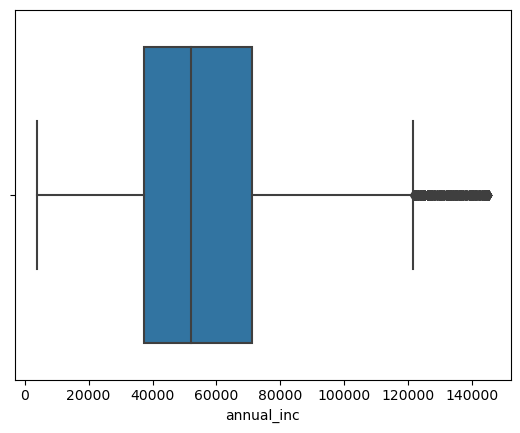

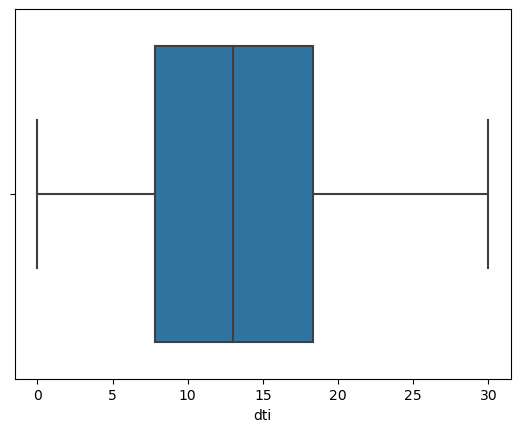

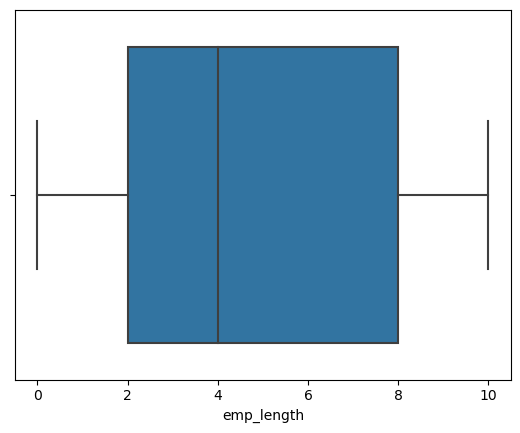

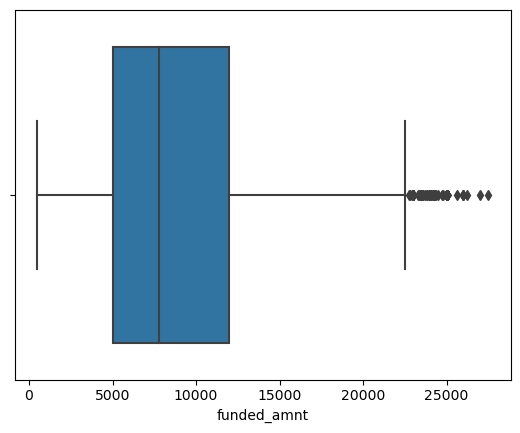

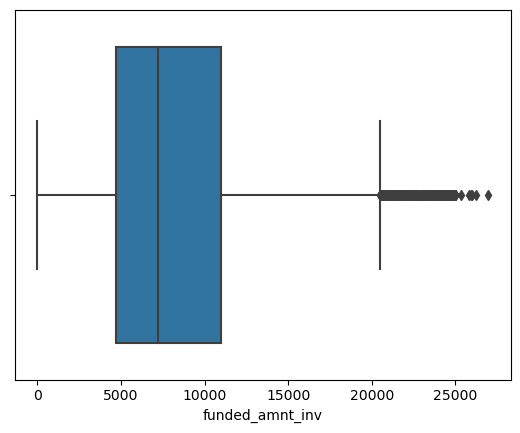

...

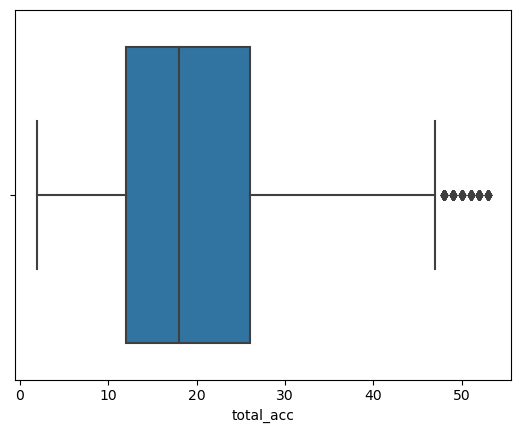

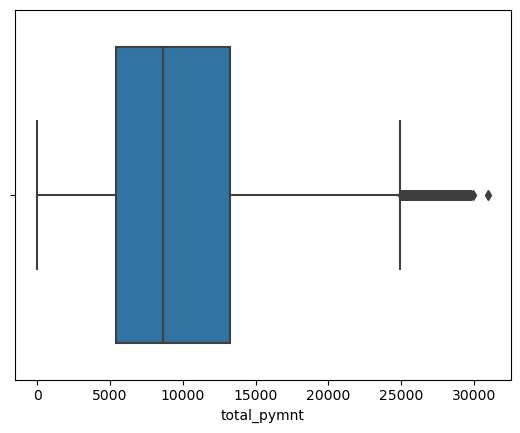

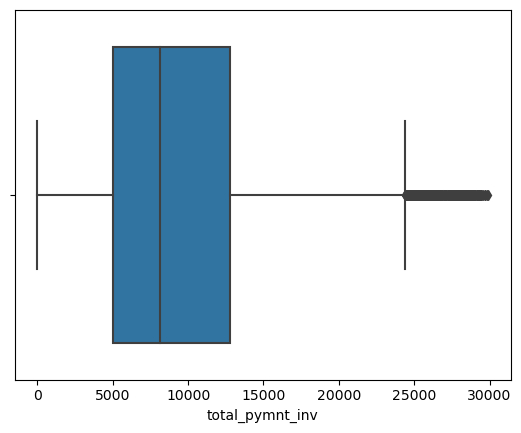

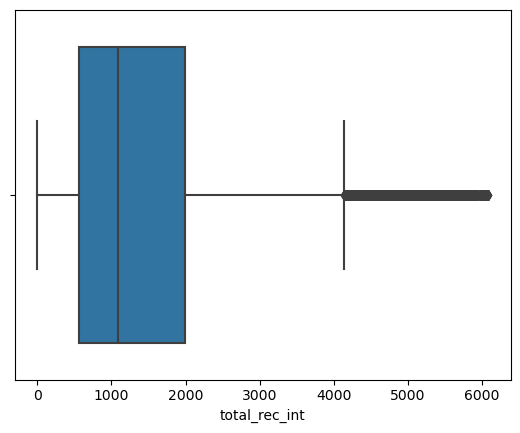

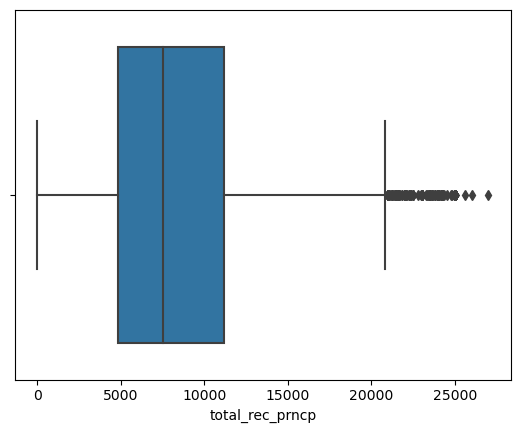

In [40]:
#checking for outliers in each columns
for col in cont_cols_lst:
        sns.boxplot(x=df[col])
        plt.show()

#### Adding drived columns for Time series columns

In [41]:
#drive month and year column for earliest cr line month
df['earliest_cr_line_month'] = pd.to_datetime(df['earliest_cr_line'], format='%b-%y').dt.month
df['earliest_cr_line_year'] = pd.to_datetime(df['earliest_cr_line'], format='%b-%y').dt.year
df.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,...,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,pub_rec_bankruptcies,last_pymnt_d_month,last_pymnt_d_year,earliest_cr_line_month,earliest_cr_line_year
0,5000,5000,4975.0,36,10.65,162.87,B,B2,10,RENT,...,0.0,0.0,Jan-15,171.62,May-16,0.0,1.0,2015.0,1,1985
2,2400,2400,2400.0,36,15.96,84.33,C,C5,10,RENT,...,0.0,0.0,Jun-14,649.91,May-16,0.0,6.0,2014.0,11,2001
6,7000,7000,7000.0,60,15.96,170.08,C,C5,8,RENT,...,0.0,0.0,May-16,1313.76,May-16,0.0,5.0,2016.0,7,2005
7,3000,3000,3000.0,36,18.64,109.43,E,E1,9,RENT,...,0.0,0.0,Jan-15,111.34,Dec-14,0.0,1.0,2015.0,1,2007
10,6500,6500,6500.0,60,14.65,153.45,C,C3,5,OWN,...,0.0,0.0,Jun-13,1655.54,Dec-15,0.0,6.0,2013.0,1,1998


In [42]:
#drive month and year column for earliest cr line month
df['issue_d_month'] = pd.to_datetime(df['issue_d'], format='%b-%y').dt.month
df['issue_d_year'] = pd.to_datetime(df['issue_d'], format='%b-%y').dt.year
df.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,...,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,pub_rec_bankruptcies,last_pymnt_d_month,last_pymnt_d_year,earliest_cr_line_month,earliest_cr_line_year,issue_d_month,issue_d_year
0,5000,5000,4975.0,36,10.65,162.87,B,B2,10,RENT,...,Jan-15,171.62,May-16,0.0,1.0,2015.0,1,1985,12,2011
2,2400,2400,2400.0,36,15.96,84.33,C,C5,10,RENT,...,Jun-14,649.91,May-16,0.0,6.0,2014.0,11,2001,12,2011
6,7000,7000,7000.0,60,15.96,170.08,C,C5,8,RENT,...,May-16,1313.76,May-16,0.0,5.0,2016.0,7,2005,12,2011
7,3000,3000,3000.0,36,18.64,109.43,E,E1,9,RENT,...,Jan-15,111.34,Dec-14,0.0,1.0,2015.0,1,2007,12,2011
10,6500,6500,6500.0,60,14.65,153.45,C,C3,5,OWN,...,Jun-13,1655.54,Dec-15,0.0,6.0,2013.0,1,1998,12,2011


In [43]:
#drive month and year column for earliest cr line month
df['last_credit_pull_d_month'] = pd.to_datetime(df['last_credit_pull_d'], format='%b-%y').dt.month
df['last_credit_pull_d_year'] = pd.to_datetime(df['last_credit_pull_d'], format='%b-%y').dt.year
df.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,...,last_credit_pull_d,pub_rec_bankruptcies,last_pymnt_d_month,last_pymnt_d_year,earliest_cr_line_month,earliest_cr_line_year,issue_d_month,issue_d_year,last_credit_pull_d_month,last_credit_pull_d_year
0,5000,5000,4975.0,36,10.65,162.87,B,B2,10,RENT,...,May-16,0.0,1.0,2015.0,1,1985,12,2011,5.0,2016.0
2,2400,2400,2400.0,36,15.96,84.33,C,C5,10,RENT,...,May-16,0.0,6.0,2014.0,11,2001,12,2011,5.0,2016.0
6,7000,7000,7000.0,60,15.96,170.08,C,C5,8,RENT,...,May-16,0.0,5.0,2016.0,7,2005,12,2011,5.0,2016.0
7,3000,3000,3000.0,36,18.64,109.43,E,E1,9,RENT,...,Dec-14,0.0,1.0,2015.0,1,2007,12,2011,12.0,2014.0
10,6500,6500,6500.0,60,14.65,153.45,C,C3,5,OWN,...,Dec-15,0.0,6.0,2013.0,1,1998,12,2011,12.0,2015.0


In [44]:
#drive month and year column for earliest cr line month
df['last_pymnt_d_month'] = pd.to_datetime(df['last_pymnt_d'], format='%b-%y').dt.month
df['last_pymnt_d_year'] = pd.to_datetime(df['last_pymnt_d'], format='%b-%y').dt.year
df.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,...,last_credit_pull_d,pub_rec_bankruptcies,last_pymnt_d_month,last_pymnt_d_year,earliest_cr_line_month,earliest_cr_line_year,issue_d_month,issue_d_year,last_credit_pull_d_month,last_credit_pull_d_year
0,5000,5000,4975.0,36,10.65,162.87,B,B2,10,RENT,...,May-16,0.0,1.0,2015.0,1,1985,12,2011,5.0,2016.0
2,2400,2400,2400.0,36,15.96,84.33,C,C5,10,RENT,...,May-16,0.0,6.0,2014.0,11,2001,12,2011,5.0,2016.0
6,7000,7000,7000.0,60,15.96,170.08,C,C5,8,RENT,...,May-16,0.0,5.0,2016.0,7,2005,12,2011,5.0,2016.0
7,3000,3000,3000.0,36,18.64,109.43,E,E1,9,RENT,...,Dec-14,0.0,1.0,2015.0,1,2007,12,2011,12.0,2014.0
10,6500,6500,6500.0,60,14.65,153.45,C,C3,5,OWN,...,Dec-15,0.0,6.0,2013.0,1,1998,12,2011,12.0,2015.0


#### Drived columns list

In [45]:
drv_cols_lst = ['earliest_cr_line_month','earliest_cr_line_year','issue_d_month','issue_d_year','last_credit_pull_d_month','last_credit_pull_d_year','last_pymnt_d_month','last_pymnt_d_month']
df[drv_cols_lst]

,earliest_cr_line_month,earliest_cr_line_year,issue_d_month,issue_d_year,last_credit_pull_d_month,last_credit_pull_d_year,last_pymnt_d_month,last_pymnt_d_month
0,1,1985,12,2011,5.0,2016.0,1.0,1.0
2,11,2001,12,2011,5.0,2016.0,6.0,6.0
6,7,2005,12,2011,5.0,2016.0,5.0,5.0
7,1,2007,12,2011,12.0,2014.0,1.0,1.0
10,1,1998,12,2011,12.0,2015.0,6.0,6.0
...,...,...,...,...,...,...,...,...
39704,9,2000,7,2007,7.0,2010.0,7.0,7.0
39705,10,1997,7,2007,6.0,2010.0,7.0,7.0
39708,8,1995,7,2007,6.0,2010.0,7.0,7.0
39710,10,1997,7,2007,6.0,2007.0,7.0,7.0




### Reviewing Quantitive colums

In [46]:
#looking into standard statics of each column
for col in cont_cols_lst:
    print(f'{df[col].describe()}\n')

count     19424.000000
mean      56701.775216
std       26274.206119
min        4000.000000
25%       37400.000000
50%       51996.000000
75%       71023.735000
max      145000.000000
Name: annual_inc, dtype: float64

count    19424.000000
mean        13.051144
std          6.728649
min          0.000000
25%          7.790000
50%         13.040000
75%         18.302500
max         29.990000
Name: dti, dtype: float64

count    19424.000000
mean         4.733268
std          3.521903
min          0.000000
25%          2.000000
50%          4.000000
75%          8.000000
max         10.000000
Name: emp_length, dtype: float64

count    19424.000000
mean      8566.897910
std       4930.639017
min        500.000000
25%       5000.000000
50%       7762.500000
75%      12000.000000
max      27500.000000
Name: funded_amnt, dtype: float64

count    19424.000000
mean      8168.165937
std       4874.888300
min          0.000000
25%       4675.000000
50%       7200.000000
75%      11000.000000
max 

In [47]:
#checking values of quantitative columns
df[cont_cols_lst]

,annual_inc,dti,emp_length,funded_amnt,funded_amnt_inv,inq_last_6mths,installment,int_rate,last_pymnt_amnt,loan_amnt,open_acc,revol_bal,revol_util,total_acc,total_pymnt,total_pymnt_inv,total_rec_int,total_rec_prncp
0,24000.0,27.65,10,5000,4975.0,1,162.87,10.65,171.62,5000,3,13648,83.7,9,5863.155187,5833.84,863.16,5000.00
2,12252.0,8.72,10,2400,2400.0,2,84.33,15.96,649.91,2400,2,2956,98.5,10,3005.666844,3005.67,605.67,2400.00
6,47004.0,23.51,8,7000,7000.0,1,170.08,15.96,1313.76,7000,7,17726,85.6,11,10110.840000,10110.84,3125.23,6985.61
7,48000.0,5.35,9,3000,3000.0,2,109.43,18.64,111.34,3000,4,8221,87.5,4,3939.135294,3939.14,939.14,3000.00
10,72000.0,16.12,5,6500,6500.0,2,153.45,14.65,1655.54,6500,14,4032,20.6,23,7678.017673,7678.02,1178.02,6500.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39704,25000.0,14.54,0,3000,950.0,1,94.98,8.70,97.45,3000,10,3660,7.8,13,3419.144850,1082.73,419.14,3000.00
39705,120000.0,2.29,8,5000,250.0,0,155.38,7.43,157.02,5000,8,8379,16.9,16,5593.631701,279.69,593.63,5000.00
39708,48000.0,8.03,4,5000,375.0,1,161.25,9.96,162.07,5000,6,28329,48.6,6,5804.732505,435.36,804.73,5000.00
39710,85000.0,0.31,1,5000,250.0,0,155.38,7.43,156.29,5000,7,216,0.6,19,5593.626092,279.68,593.63,5000.00


### Reviewing Categorical columns

In [48]:
#looking into statics of each column
for col in cat_cols_lst:
    print(f'{df[col].describe()}\n')

count     19424
unique        7
top           A
freq       7084
Name: grade, dtype: object

count     19424
unique        5
top        RENT
freq      10419
Name: home_ownership, dtype: object

count          19424
unique             2
top       Fully Paid
freq           18743
Name: loan_status, dtype: object

count                  19424
unique                    14
top       debt_consolidation
freq                    8729
Name: purpose, dtype: object

count     19424
unique       35
top          A4
freq       1963
Name: sub_grade, dtype: object

count            19424
unique               3
top       Not Verified
freq              9784
Name: verification_status, dtype: object



In [49]:
#checking values of categorical columns
df[cat_cols_lst]

,grade,home_ownership,loan_status,purpose,sub_grade,verification_status
0,B,RENT,Fully Paid,credit_card,B2,Verified
2,C,RENT,Fully Paid,small_business,C5,Not Verified
6,C,RENT,Fully Paid,debt_consolidation,C5,Not Verified
7,E,RENT,Fully Paid,car,E1,Source Verified
10,C,OWN,Fully Paid,debt_consolidation,C3,Not Verified
...,...,...,...,...,...,...
39704,B,MORTGAGE,Fully Paid,small_business,B1,Not Verified
39705,A,MORTGAGE,Fully Paid,debt_consolidation,A2,Not Verified
39708,B,MORTGAGE,Fully Paid,debt_consolidation,B5,Not Verified
39710,A,OWN,Fully Paid,credit_card,A2,Not Verified


### Reviewing Time Series columns

In [50]:
#looking into statics of time series columns
for col in tim_cols_lst:
    print(f'{df[col].describe()}\n')

count      19424
unique       494
top       Oct-99
freq         197
Name: earliest_cr_line, dtype: object

count      19424
unique        54
top       Dec-11
freq         991
Name: issue_d, dtype: object

count      19423
unique        91
top       May-16
freq        4672
Name: last_credit_pull_d, dtype: object

count      19415
unique        89
top       Dec-14
freq         641
Name: last_pymnt_d, dtype: object



In [51]:
#checking data of time series columns
df[tim_cols_lst]

,earliest_cr_line,issue_d,last_credit_pull_d,last_pymnt_d
0,Jan-85,Dec-11,May-16,Jan-15
2,Nov-01,Dec-11,May-16,Jun-14
6,Jul-05,Dec-11,May-16,May-16
7,Jan-07,Dec-11,Dec-14,Jan-15
10,Jan-98,Dec-11,Dec-15,Jun-13
...,...,...,...,...
39704,Sep-00,Jul-07,Jul-10,Jul-10
39705,Oct-97,Jul-07,Jun-10,Jul-10
39708,Aug-95,Jul-07,Jun-10,Jul-10
39710,Oct-97,Jul-07,Jun-07,Jul-10


### Univariate Analysis

#### Performing univariate analysis for Quantitative columns

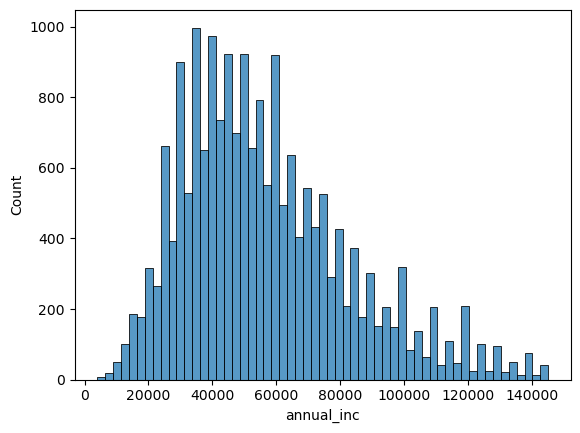

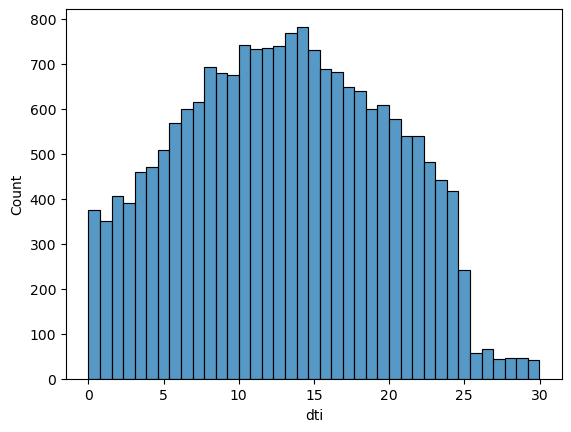

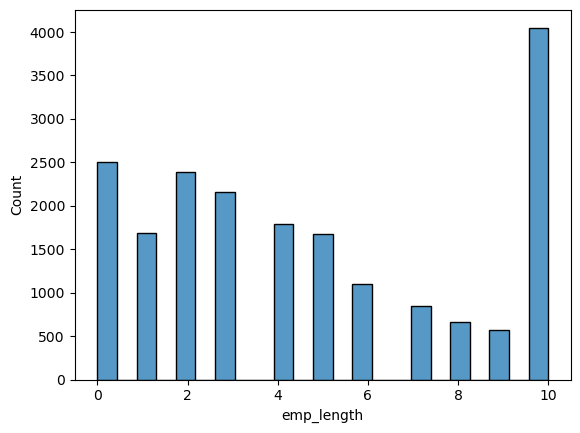

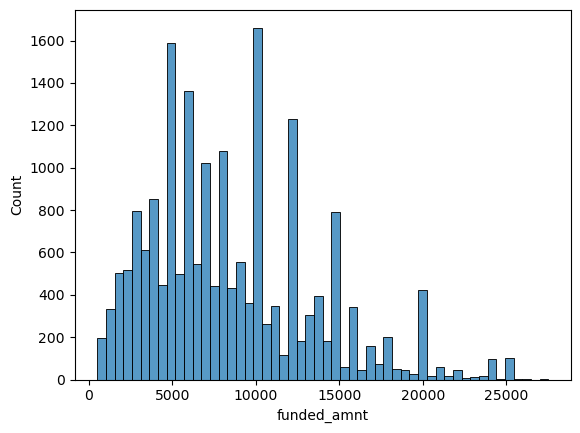

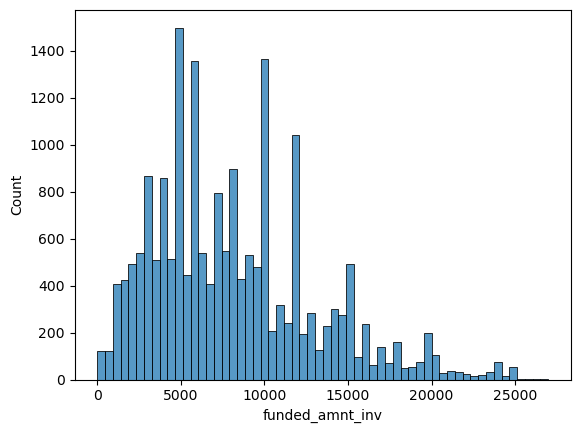

...

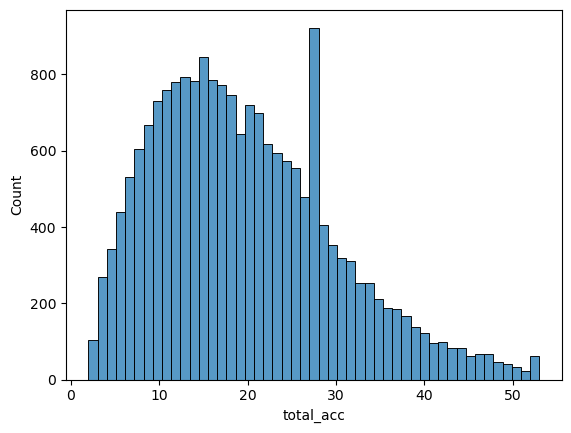

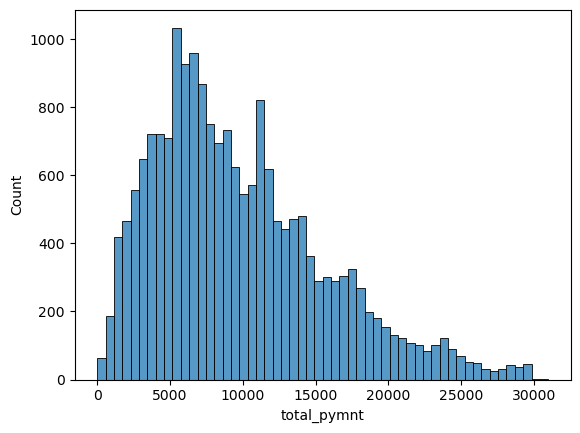

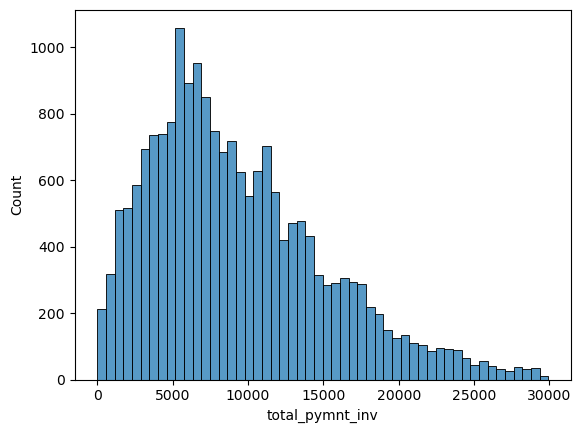

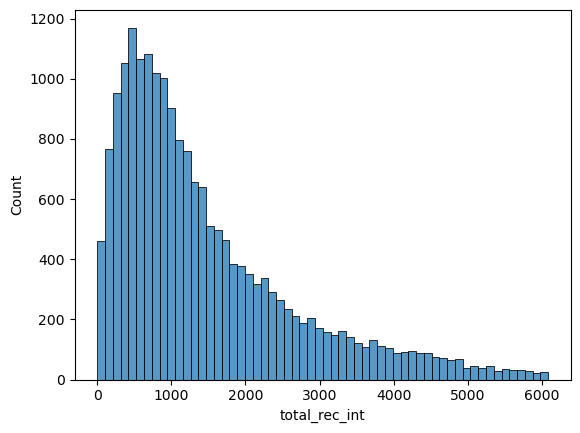

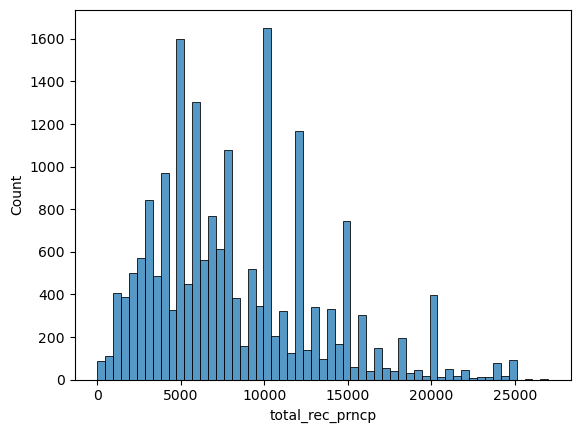

In [52]:
#ploting histogram against all quantitative columns for univariate analysis
for col in cont_cols_lst:
    sns.histplot(x=df[col])
    plt.show()

#### Performing univariate analysis on Categorical columns

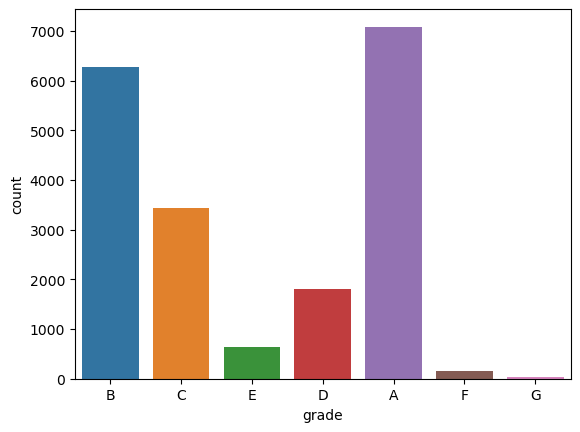

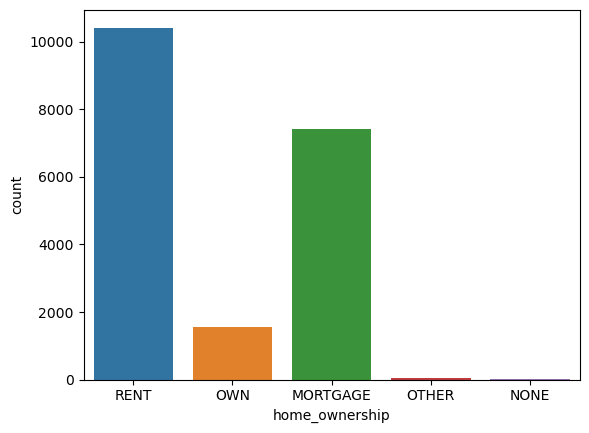

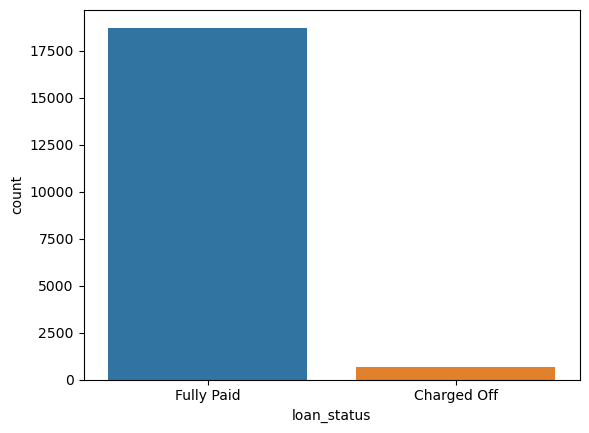

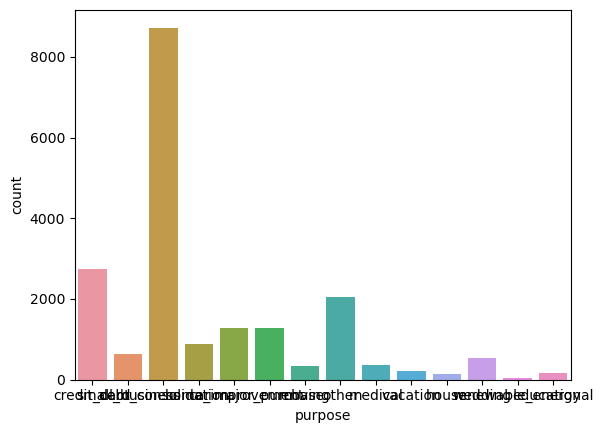

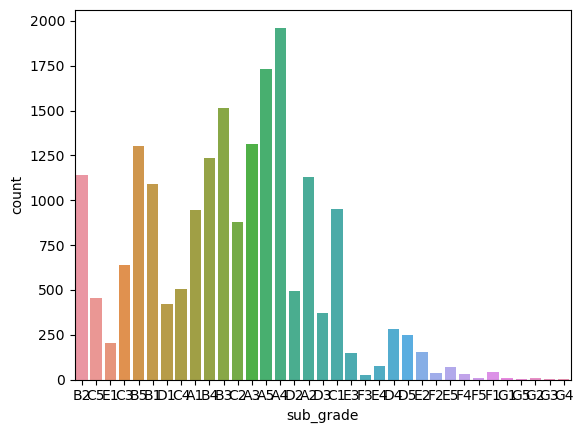

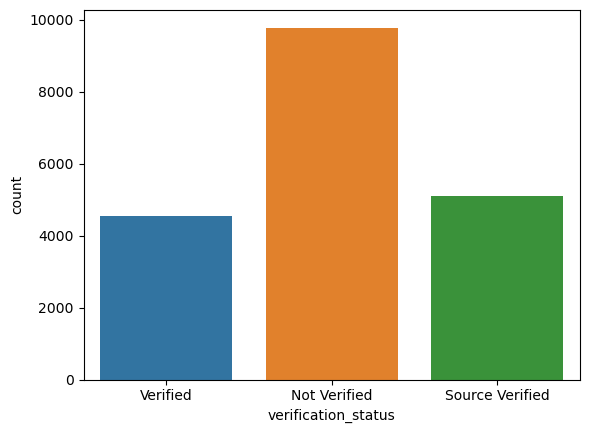

In [53]:
#ploting count plot against all categorical columns for univariate analysis
for cat in cat_cols_lst:
    sns.countplot(x=df[cat])
    plt.show()

#### Performing univariate analysis on Drived columns

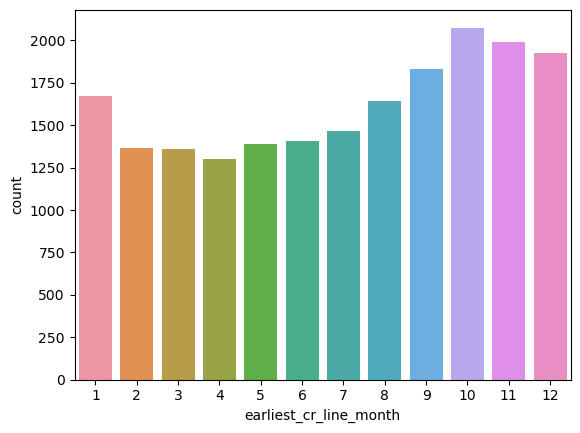

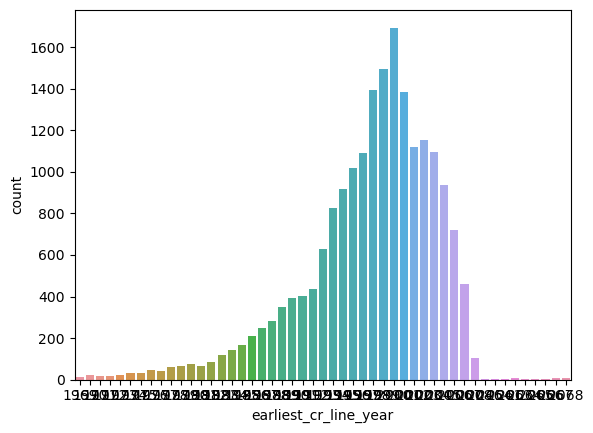

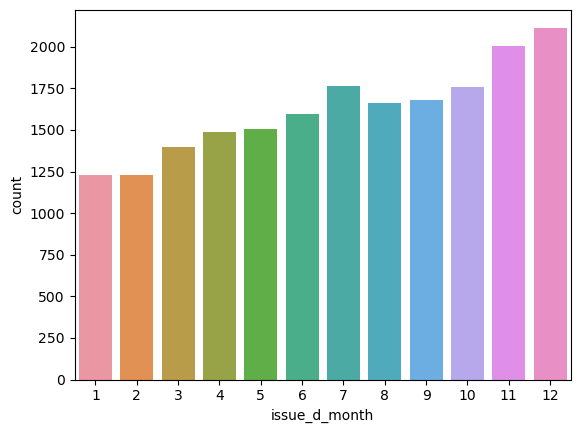

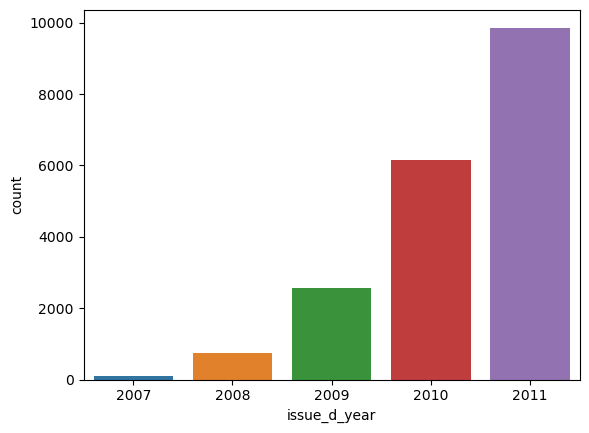

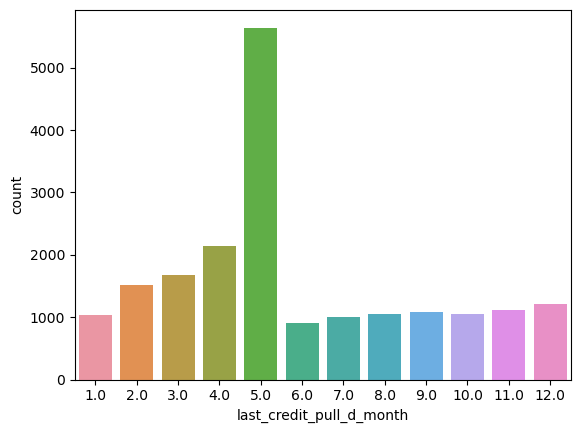

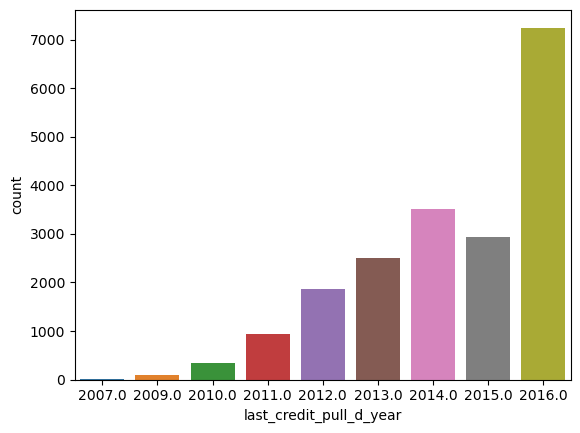

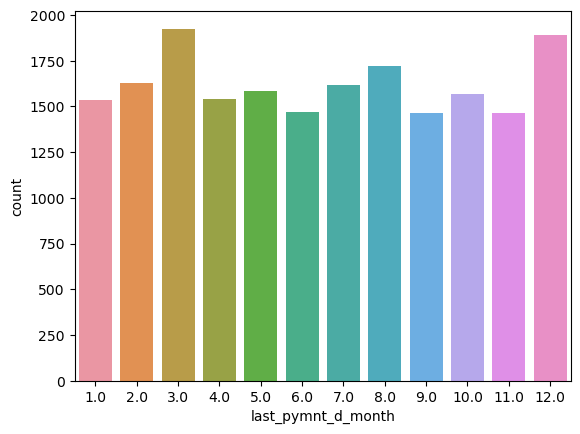

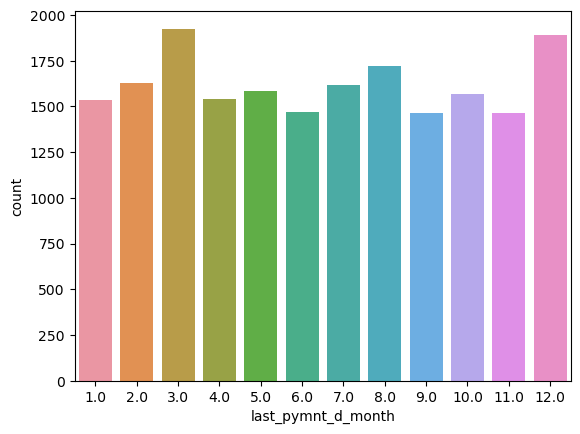

In [54]:
#ploting count plot against drived columns for univariate analysis
for drv in drv_cols_lst:
    sns.countplot(x=df[drv])
    plt.show()

### Bivariate Analysis

#### Performing bivariate analysis between Quantitive Columns

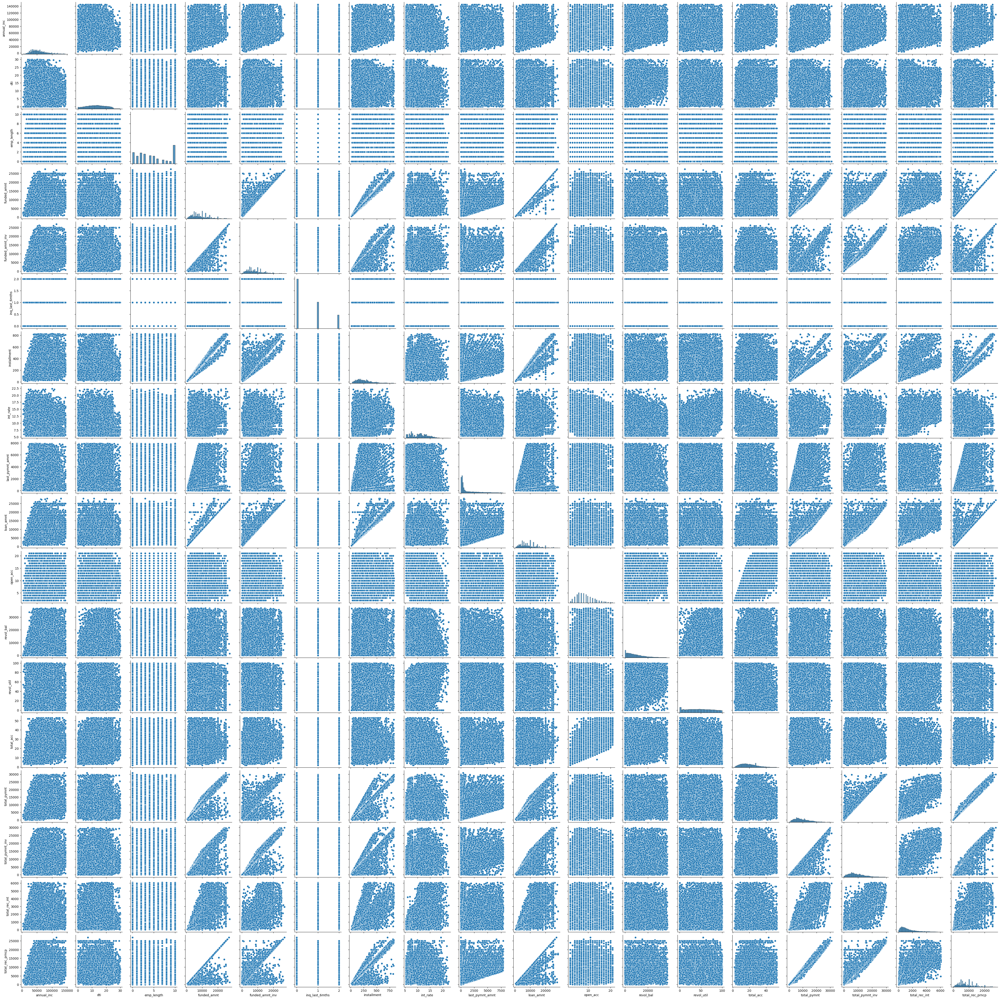

In [55]:
#ploting pair plot against all quantative columns for bivariate analysis
sns.pairplot(df[cont_cols_lst])
plt.show()

#### Performing bivariate analysis between Categorical Vs Quantitive Columns

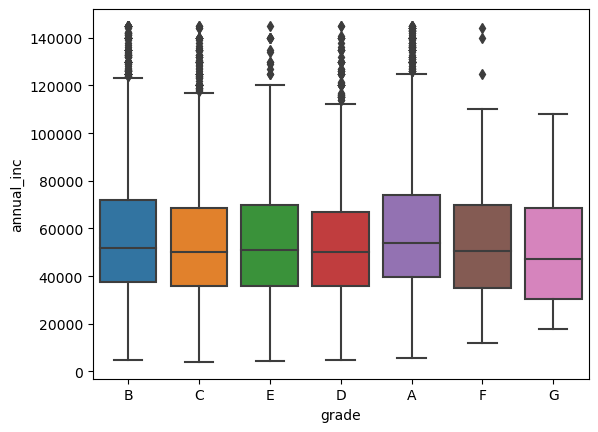

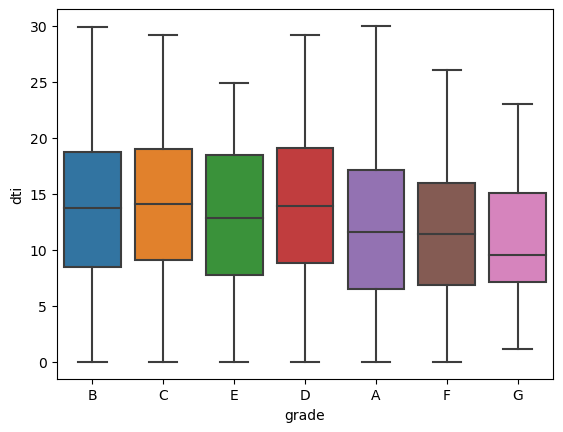

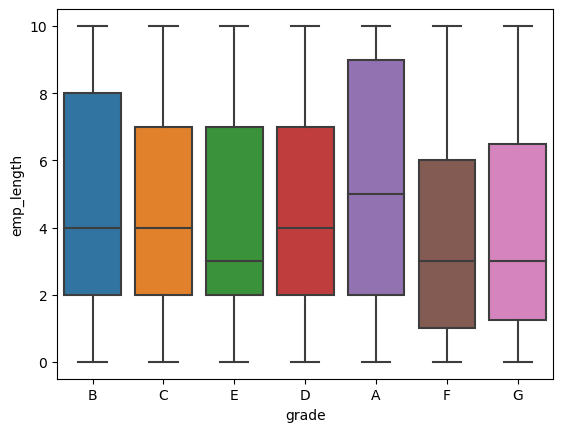

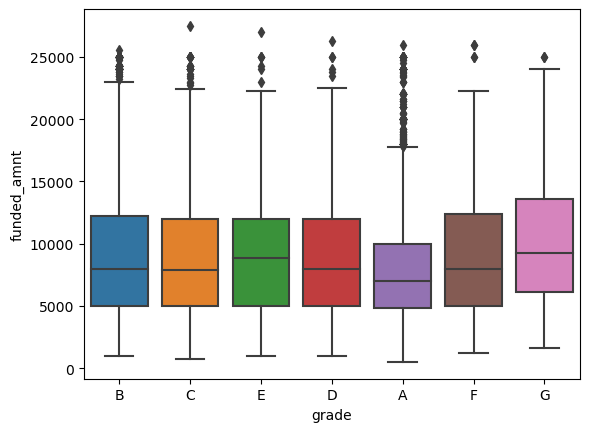

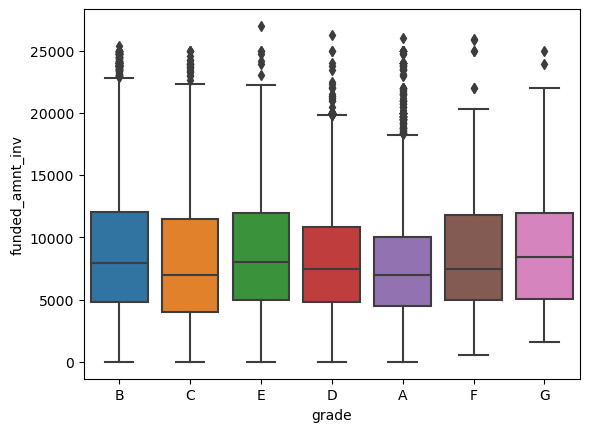

...

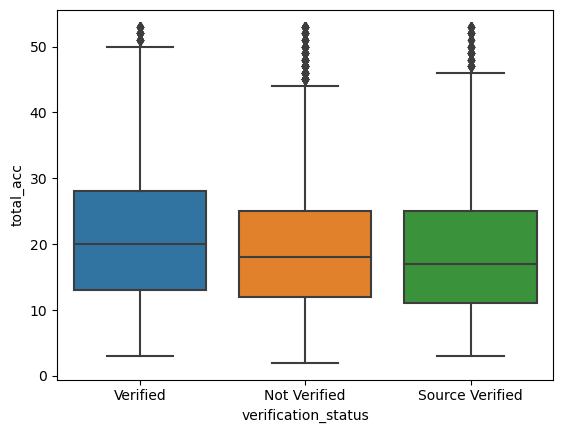

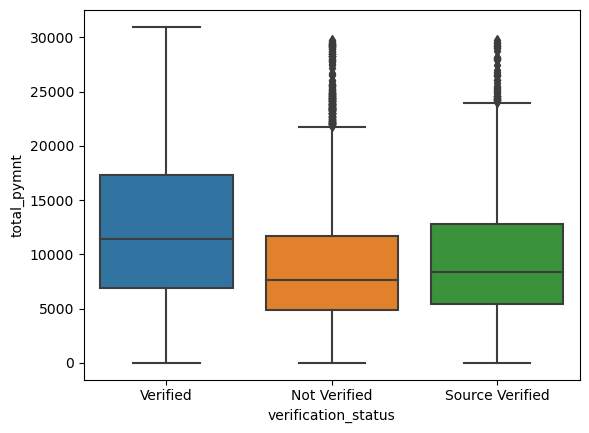

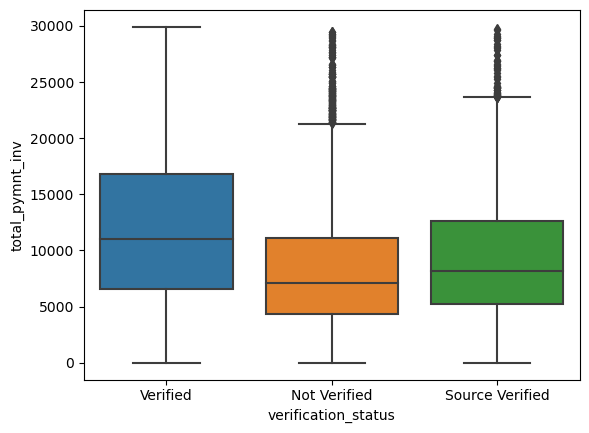

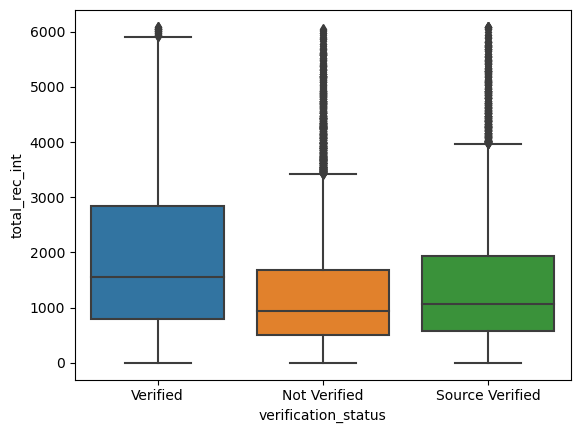

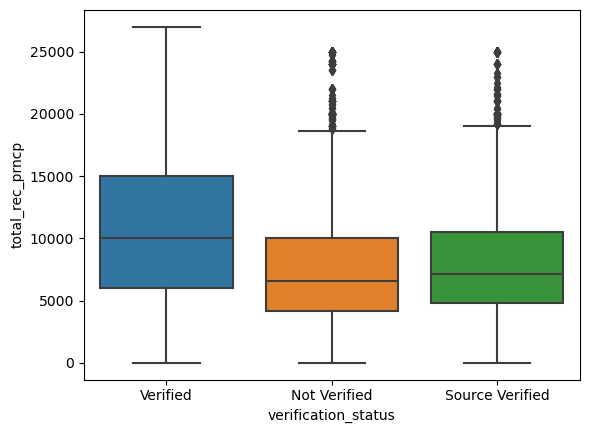

In [56]:
#ploting box plot showing result for each categorical column against each quantative column 
#for bivariate analysis
for col1 in cat_cols_lst:
    for col2 in cont_cols_lst:
        sns.boxplot(x=df[col1], y=df[col2])
        plt.show()

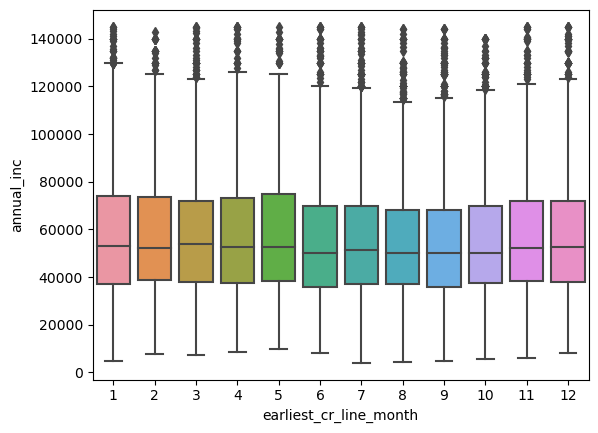

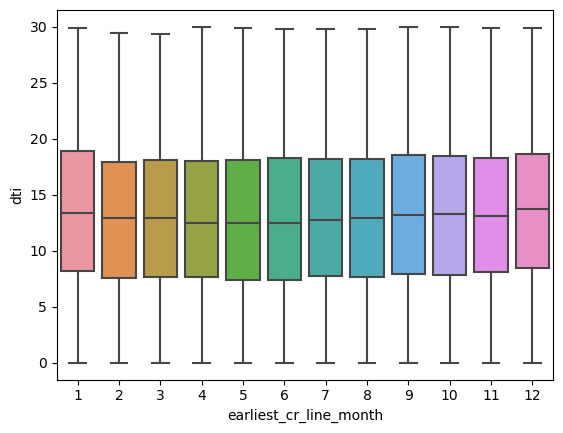

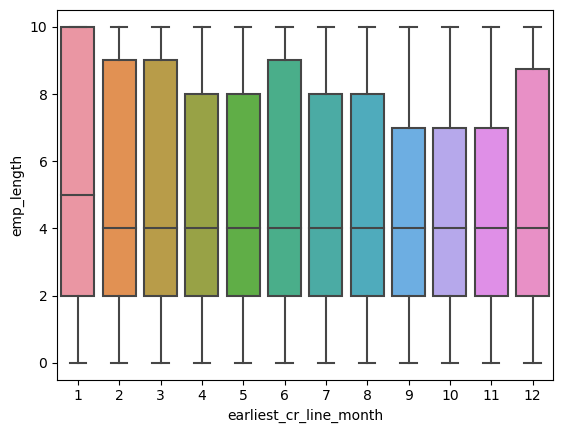

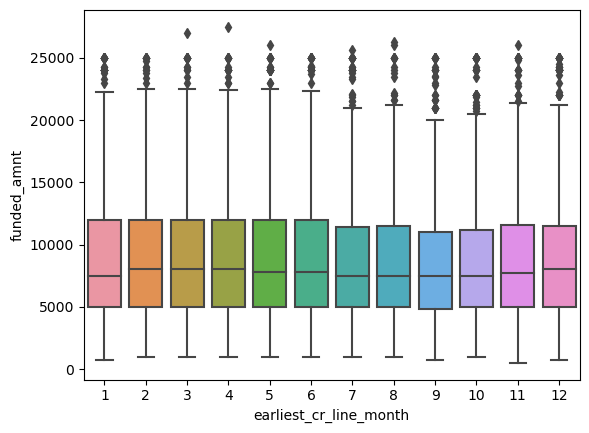

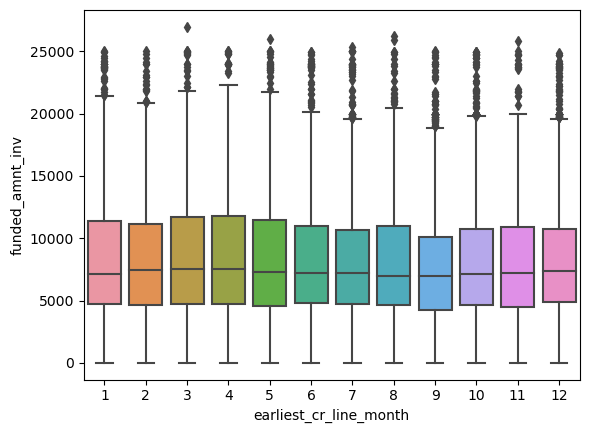

...

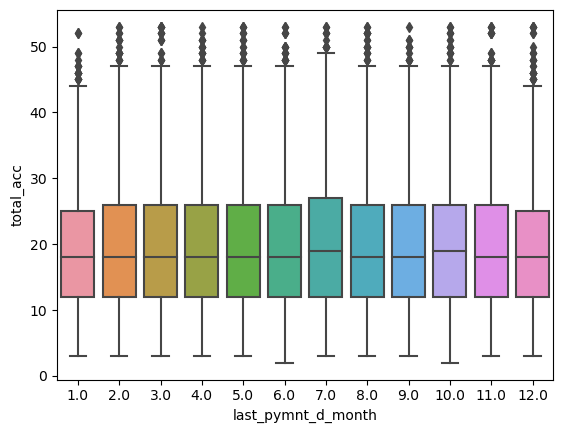

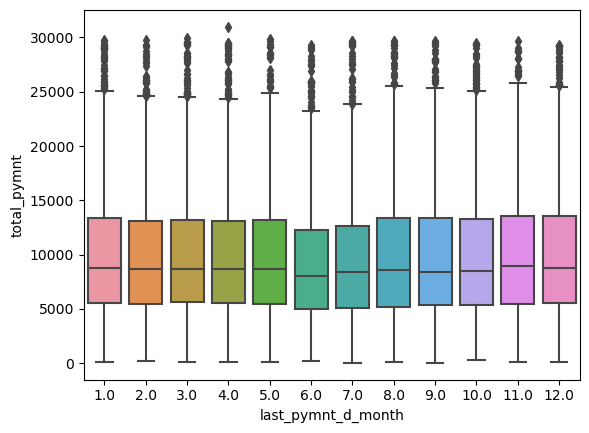

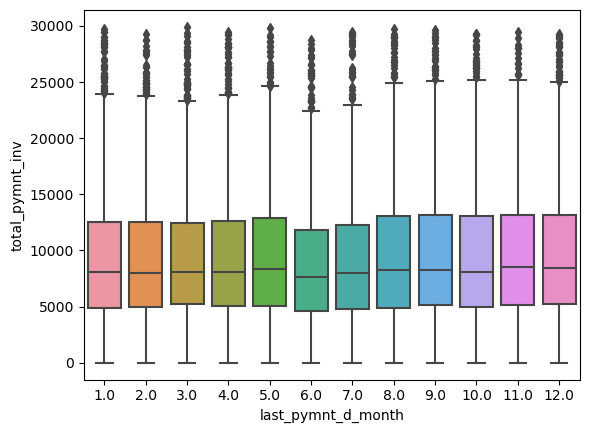

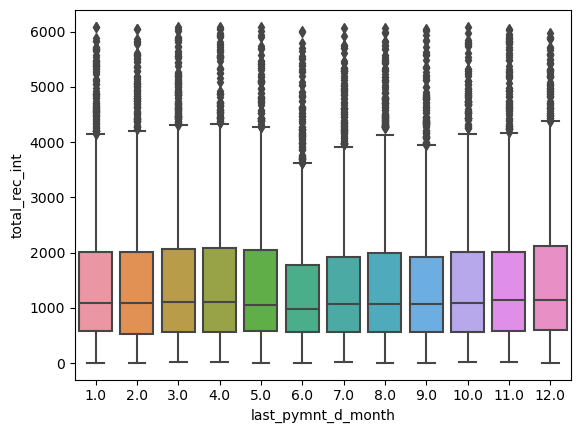

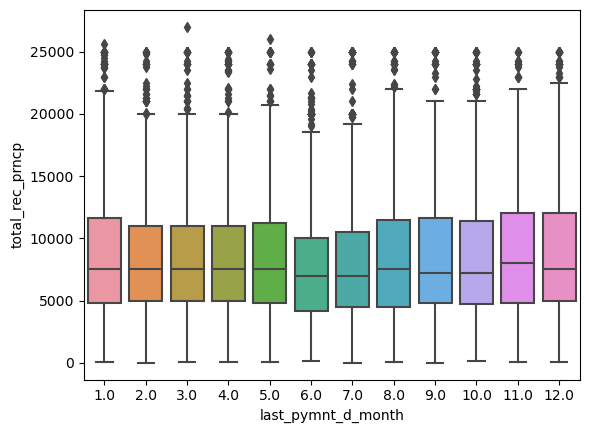

In [57]:
#ploting box plot showing result for each drived column against each quantative column 
#for bivariate analysis
for col1 in drv_cols_lst:
    for col2 in cont_cols_lst:
        sns.boxplot(x=df[col1], y=df[col2])
        plt.show()

#### Finding corelation between columns

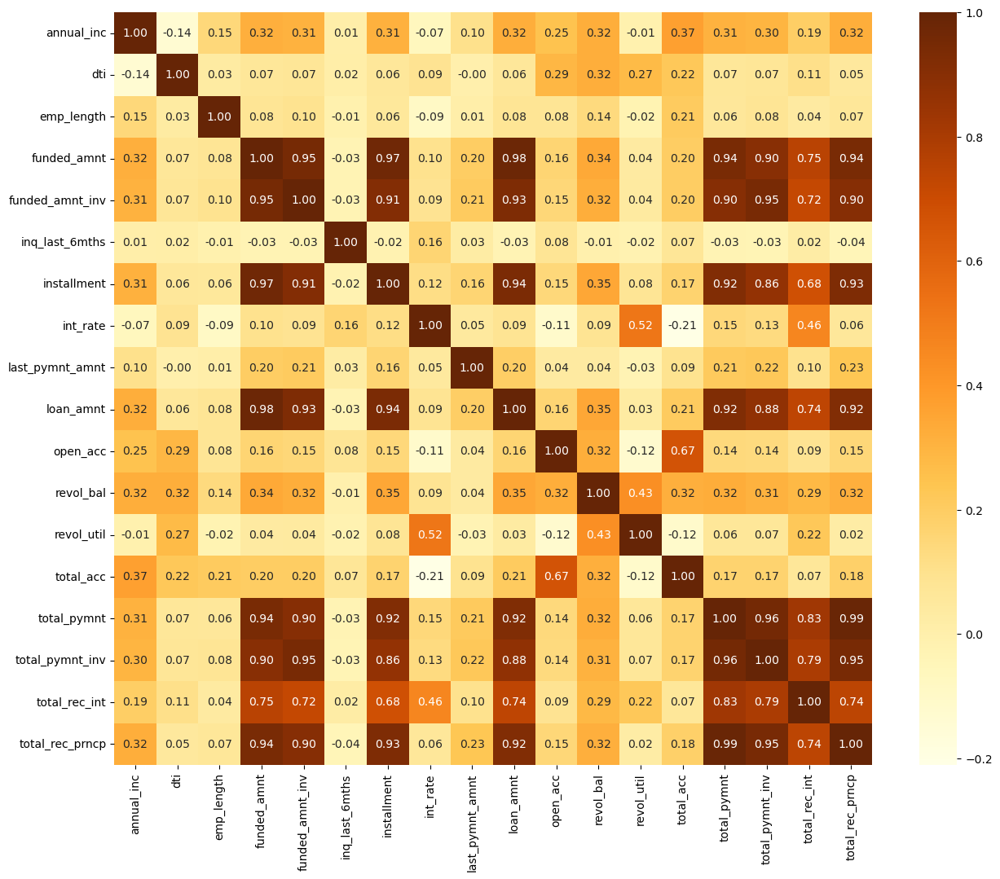

In [58]:
#ploting heat map showing corelation between different columns for bivariate analysis
hm_df = df[cont_cols_lst]
plt.figure(figsize=(15,12))
sns.heatmap(hm_df.corr(), annot=True, fmt='.2f', cmap="YlOrBr")
plt.show()